# Reinforcement Learning: DQN

- As before, please keep the names of the layer consistent with what is requested in model.py. Otherwise the test functions will not work

- You will need to fill in the model.py, DQN.py, replay_buffer.py, and env_wrapper.py.

To avoid pain with installation and model training, please use Colab for this project. DO NOT use Windows for this project. If you use Mac, there might be some potential test case failures you need to address with extra effort.

## Set up

In [2]:
# # mount it if you use Colab
# from google.colab import drive
# drive.mount('/content/drive')

In [3]:
# # TODO: change the dir to your folder
# %cd /content/drive/MyDrive/YOUR_FOLDER_NAME

In [4]:
%load_ext autoreload
%autoreload 2

In [5]:
# !pip install numpy torch wandb swig matplotlib termcolor
# !pip install gymnasium
# !pip install gymnasium[box2d]

In [6]:
import os
os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"

In [7]:
import rl_test
from utils import *

## Introduction to the Enviroment (5 points)
We will be training a DQN agent to play the game of CarRacing. The agent will be trained to play the game using the pixels of the game as an input. The reward structure is as follows for each frame:
- -0.1 for each frame
- +1000/N where N is the number of tiles visited by the car in the episode

The overall goal of this game is to design a agent that is able to play the game with a average test score of above 600. In discrete mode the actions can take 5 actions,
- 0: Do Nothing
- 1: Turn Left
- 2: Turn Right
- 3: Accelerate
- 4: Brake

First let us visualize the game and understand the environment.

In [8]:
import gymnasium as gym
import numpy as np
env = gym.make('CarRacing-v3', continuous=False, render_mode='rgb_array')
env.np_random = np.random.RandomState(42)

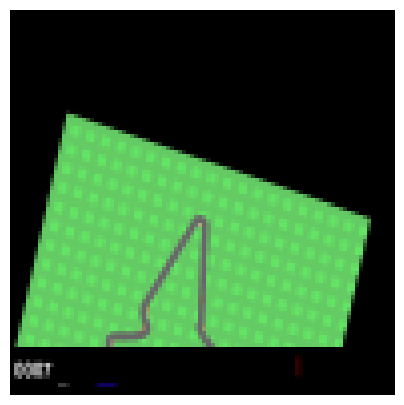

In [9]:
from IPython.display import HTML

frames = []
s, _ = env.reset()

while True:
    a = env.action_space.sample()
    s, r, terminated, truncated, _ = env.step(a)
    frames.append(s)
    if terminated or truncated:
        break

anim = animate(frames)
HTML(anim.to_jshtml())

So a couple things we can note:
- at the beginning of the game, we have 50 frames of the game slowly zooming into the car, we should ignore this period, ie no-op during this period.
- there is a black bar at the bottom of the screen, we should crop this out of the observation.

In addition, another thing to note is that the current frame doesn't give much information about the velocity and acceleration of the car, and that the car does not move much for each frame.

### Environment Wrapper (5 points)
As a result, you will need to complete `EnvWrapper` in `env_wrapper.py`. You can find more information in the docstring for the wrapper, however the main idea is that it is a wrapper to the environment that does the following:
- skips the first 50 frames of the game
- crops out the black bar and reshapes the observation to a 84x84 image, as well as turning the resulting image to grayscale
- performs the actions for `skip_frames` frames
- stacks the last `num_frames` frames together to give the agent some information about the velocity and acceleration of the car.


In [10]:
from env_wrapper import EnvWrapper

rl_test.test_wrapper(EnvWrapper)

Passed reset
Passed step


## DQN (25 points)

### CNN Model (5 points)
Now we are ready to build the model. Our architecture of the CNN model is the one proposed by Mnih et al in "Human-level control through deep reinforcement learning". Specifically this consists of the following layers:
- A convolutional layer with 32 filters of size 8x8 with stride 4 and relu activation
- A convolutional layer with 64 filters of size 4x4 with stride 2 and relu activation
- A convolutional layer with 64 filters of size 3x3 with stride 1 and relu activation
- A fully connected layer with 512 units and relu activation
- A fully connected layer with the number of outputs of the environment

Please implement this model `Nature_Paper_Conv` in `model.py` as well as the helper
`MLP` class.

In [11]:
import model
rl_test.test_model_DQN(model.Nature_Paper_Conv)

Passed


Now we are ready to implement the DQN algorithm.

![title](DQN.png)

### Replay Buffer (5 points)
First start by implementing the DQN replay buffer `ReplayBufferDQN` in `replay_buffer.py`. This buffer will store the transitions of the agent and sample them for training.

In [12]:
from replay_buffer import ReplayBufferDQN

rl_test.test_DQN_replay_buffer(ReplayBufferDQN)

Passed



### DQN (15 points)
Now implement the `_optimize_model` and `_sample_action` functions in `DQN` in `DQN.py`. The `_optimize_model` function will sample a batch of transitions from the replay buffer and update the model. The `_sample_action` function will sample an action from the model given the current state. Train the model over 200 episdoes, validating every 50 episodes for 30 episodes, before testing the model for 50 episodes at the end.

In [13]:
import wandb

In [14]:
wandb.login()

wandb: Currently logged in as: lyuchenandy (lyuchenandy-ucla) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


True

In [15]:
wandb.init(project="racing-car-dqn")

In [17]:
import DQN
import utils
import torch

# if running with Colab T4 with wandb, it takes 60-70 mins
# if running with Colab T4 w/o wandb, it takes ~30 mins
# your test mean reward idealy should be larger than 400
trainerDQN = DQN.DQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 700, 0.1),
                save_path = utils.get_save_path("DQN","./runs/"))

trainerDQN.train(200, 50, 30, 50, 50)



saving to ./runs/DQN\run1


loss,▁
total_reward,▁
loss,0
total_reward,-56.43846


Episode: 0: Time: 8.570188045501709 Total Reward: -12.75714285714268 Avg_Loss: 0.0
Episode: 1: Time: 14.44001817703247 Total Reward: -51.12895622895694 Avg_Loss: 0.831509803653143
Episode: 2: Time: 15.839072465896606 Total Reward: -42.08309859154951 Avg_Loss: 1.0174919520230854
Episode: 3: Time: 16.307832956314087 Total Reward: -60.548854961832696 Avg_Loss: 0.9059070426062876
Episode: 4: Time: 16.423821449279785 Total Reward: -51.931250000000695 Avg_Loss: 0.7738597797495979
Episode: 5: Time: 16.59295082092285 Total Reward: 46.40434782608999 Avg_Loss: 1.1106600958008725
Episode: 6: Time: 15.499099493026733 Total Reward: 3.5848484848475817 Avg_Loss: 1.1546314332415075
Episode: 7: Time: 16.51548719406128 Total Reward: -32.80849673202684 Avg_Loss: 1.181858411230961
Episode: 8: Time: 16.59519386291504 Total Reward: 56.72454873646563 Avg_Loss: 1.3596334341569107
Episode: 9: Time: 17.277774572372437 Total Reward: 25.94592145015038 Avg_Loss: 1.4123984054357064
Episode: 10: Time: 17.13197779655

wandb: WARNING Fatal error while uploading data. Some run data will not be synced, but it will still be written to disk. Use `wandb sync` at the end of the run to try uploading.


Please include a plot of the training and validation rewards over the episodes in the report. Anwer the question in no more than 2 sentences: Does the loss matter in DQN? Why or why not?

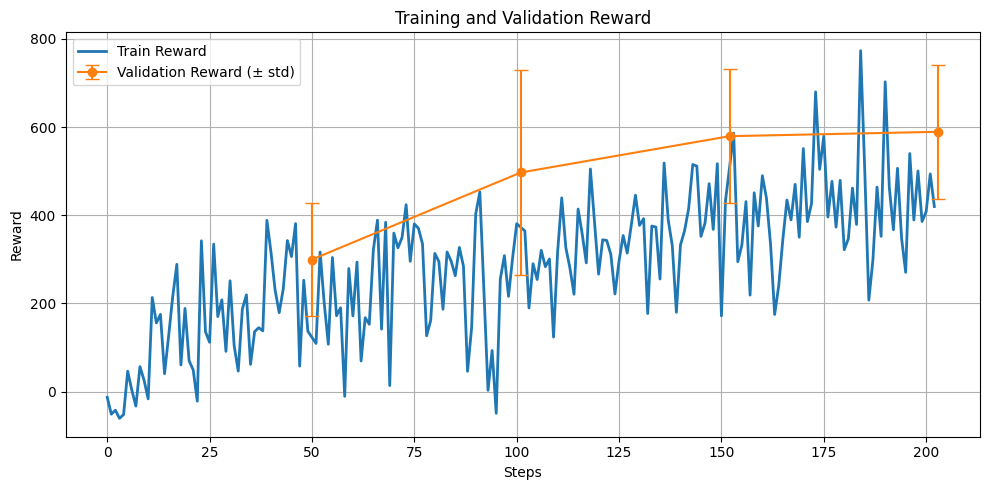

In [20]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_reward_curves(train_reward_path, val_reward_path, val_reward_std_path, log_interval=1000, save_path=None):
    """
    Plots training and validation reward curves with error bars for validation reward.
    """
    # Load CSVs
    train_df = pd.read_csv(train_reward_path)
    val_df = pd.read_csv(val_reward_path)
    val_std_df = pd.read_csv(val_reward_std_path)

    # Scale x-axis (Steps)
    train_steps = train_df["Step"] * log_interval
    val_steps = val_df["Step"] * log_interval

    # Get reward values
    train_reward = train_df.iloc[:, 1].astype(float)
    val_reward = val_df.iloc[:, 1].astype(float)
    val_std = val_std_df.iloc[:, 1].astype(float)

    # Plot
    plt.figure(figsize=(10, 5))
    plt.plot(train_steps, train_reward, label="Train Reward", linewidth=2)
    plt.errorbar(val_steps, val_reward, yerr=val_std, fmt='o-', label="Validation Reward (± std)", capsize=5)

    plt.xlabel("Steps")
    plt.ylabel("Reward")
    plt.title("Training and Validation Reward")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path)
        print(f"Plot saved to {save_path}")
    else:
        plt.show()
        
plot_reward_curves(
    train_reward_path="runs/DQN/run1/total_reward_train.csv",
    val_reward_path="runs/DQN/run1/val_reward.csv",
    val_reward_std_path="runs/DQN/run1/val_reward_std.csv",
    log_interval=1
)


Your answer: The MSE loss for learning the Q function does NOT matter that much, as the target Q value is non-stationary and depends on the current state-transition sample.

#### Animation

We can also draw a animation of the car in one game, the code is provided below. The animation is just for your reference to get a feeling of how good your model is. No need to submit in your submission. We will grade based on your plots of training and validation above.

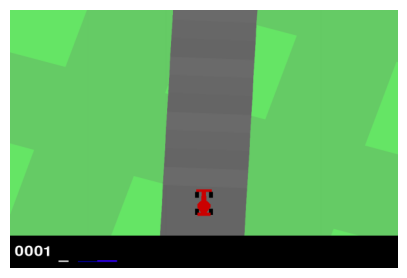

In [21]:
eval_env = gym.make('CarRacing-v3', continuous=True, render_mode='rgb_array')
eval_env = EnvWrapper(eval_env)

total_rewards, frames = trainerDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

In [22]:
print(f"Total reward for DQN: {total_rewards}")

Total reward for DQN: 668.350883392216


## Double DQN (10 points)
In the original paper, where the algorithim is shown above, the estimated target Q value was computed using the current Q network's weights. However, this can lead to overestimation of the Q values. To mitigate this, we can use the target network to compute the target Q value. This is known as Double DQN.

### Hard updating Target Network (5 points)
Original implementations for this involved hard updates, where the model weights were copied to the target network every C steps. This is known as hard updating. This was what was used in the Nature Paper by Mnih et al 2015 "Human-level control through deep reinforcement learning"

Please implement this by implementing the `_optimize_model` and `_update_model` classes in `HardUpdateDQN` in `DQN.py`.

In [23]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 100,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000, 0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates/","./runs/"))

trainerHardUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_HardUpdates/run0
Episode: 0: Time: 9.54202914237976 Total Reward: -39.162295081967436 Avg_Loss: 0.0
Episode: 1: Time: 13.963964462280273 Total Reward: -44.39494949494982 Avg_Loss: 0.7757255815349187
Episode: 2: Time: 17.51687264442444 Total Reward: -56.30350877193025 Avg_Loss: 0.7199159319035145
Episode: 3: Time: 15.20743441581726 Total Reward: -69.58354430379809 Avg_Loss: 0.5768030471004107
Episode: 4: Time: 16.309572458267212 Total Reward: -54.22203389830566 Avg_Loss: 0.5706623580557209
Episode: 5: Time: 15.940729856491089 Total Reward: -56.9253164556969 Avg_Loss: 0.5965532902158609
Episode: 6: Time: 16.78523874282837 Total Reward: -70.30983606557413 Avg_Loss: 0.5339014933859351
Episode: 7: Time: 16.505530834197998 Total Reward: -43.8489489489496 Avg_Loss: 0.49607735493478655
Episode: 8: Time: 11.043910264968872 Total Reward: -13.105109489051468 Avg_Loss: 0.48352928091742975
Episode: 9: Time: 16.778528451919556 Total Reward: -36.458441558442296 Avg_Loss: 0.

#### Animation

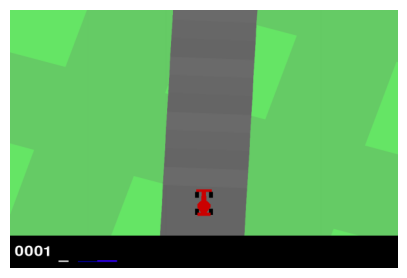

In [24]:
total_rewards, frames = trainerHardUpdateDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

In [25]:
print(f"Total reward for Hard Update Double DQN: {total_rewards}")

Total reward for Hard Update Double DQN: 505.8067137809097


### Soft Updates (5 points)
A more recent improvement is to use soft updates, also known as Polyak averaging, where the target network is updated with a small fraction of the current model weights every step. In other words:
$$\theta_{target} = \tau \theta_{model} + (1-\tau) \theta_{target}$$
for some $\tau << 1$
Please implement this by implementing the `_update_model` class in `SoftUpdateDQN` in `DQN.py`.

In [26]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.01,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,   # You can take smaller buffer size if you encounter RAM explosion
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_SoftUpdates\run0
Episode: 0: Time: 10.005537033081055 Total Reward: -68.67049180327908 Avg_Loss: 0.0
Episode: 1: Time: 13.62944221496582 Total Reward: -44.39494949494978 Avg_Loss: 0.5786261896774837
Episode: 2: Time: 15.864633083343506 Total Reward: -70.33859649122843 Avg_Loss: 0.4903626295996188
Episode: 3: Time: 16.242766618728638 Total Reward: -66.41898734177275 Avg_Loss: 0.42191784895424334
Episode: 4: Time: 18.086052417755127 Total Reward: -71.17118644067841 Avg_Loss: 0.4108056912214315
Episode: 5: Time: 18.88703227043152 Total Reward: -56.92531645569672 Avg_Loss: 0.39461291726177733
Episode: 6: Time: 15.99325942993164 Total Reward: -57.07431693989125 Avg_Loss: 0.4266979131672083
Episode: 7: Time: 20.90676259994507 Total Reward: -25.83093093093109 Avg_Loss: 0.4212664466492143
Episode: 8: Time: 18.802146434783936 Total Reward: -65.70291970802987 Avg_Loss: 0.46195724566600155
Episode: 9: Time: 19.44800305366516 Total Reward: -33.21168831168898 Avg_Loss: 0.

#### Animation

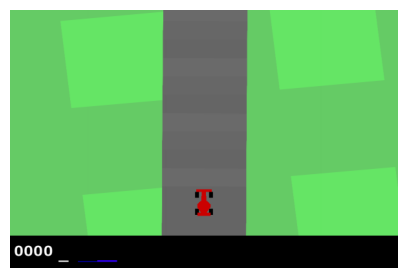

In [ ]:
total_rewards, frames = traineSoftUpdateDQN.play_episode(0, True, 40)
anim = animate(frames)
HTML(anim.to_jshtml())

In [32]:
print(f"Total reward for Soft Update Double DQN: {total_rewards}")

Total reward for Soft Update Double DQN: 435.0401197604677


## Questions (10 points)
- Which method performed better? (5 points)

Your answer:
The hard-updated double DQN performs slightly better with a mean reward of 584 and a slightly larger standard deviation. We expected soft update through Polyak averaging to yield better results with a smoothly evolving target network. But since the car racing task is simple with a small discrete action space, it is plausible that hard update and soft update lead to similar performances.

**Hard Update**:
Test Mean Reward: 584.1589964090741 Test Std Reward: 184.36789054631322

**Soft Update**:
Test Mean Reward: 546.5413383168417 Test Std Reward: 156.08258906135268

- If we modify the $\tau$ for soft updates **or** the $C$ for the hard updates, how does this affect the performance of the model, come up with a intuition for this, then experimentally verify this.
 (5 points)

In [34]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

traineSoftUpdateDQN_exp2 = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.005,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,   # You can take smaller buffer size if you encounter RAM explosion
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN_exp2.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_SoftUpdates\run1
Episode: 0: Time: 12.298422574996948 Total Reward: -44.9000000000003 Avg_Loss: 0.0
Episode: 1: Time: 18.180212020874023 Total Reward: -58.71578947368497 Avg_Loss: 0.6774275548234108
Episode: 2: Time: 22.603864192962646 Total Reward: -39.685276073619896 Avg_Loss: 0.5845176958862472
Episode: 3: Time: 22.619707822799683 Total Reward: -39.51538461538479 Avg_Loss: 0.6411755358753335
Episode: 4: Time: 21.239829063415527 Total Reward: -24.5875000000007 Avg_Loss: 0.7066802841712948
Episode: 5: Time: 22.563812017440796 Total Reward: -6.375409836066449 Avg_Loss: 0.7651742759685055
Episode: 6: Time: 22.44624972343445 Total Reward: -62.220261437909215 Avg_Loss: 0.6713037671004775
Episode: 7: Time: 22.668804168701172 Total Reward: -15.952631578947464 Avg_Loss: 0.6671866999641687
Episode: 8: Time: 23.025738954544067 Total Reward: -69.53768115942077 Avg_Loss: 0.6537697869313865
Episode: 9: Time: 21.671624422073364 Total Reward: -12.39174917491828 Avg_Loss: 

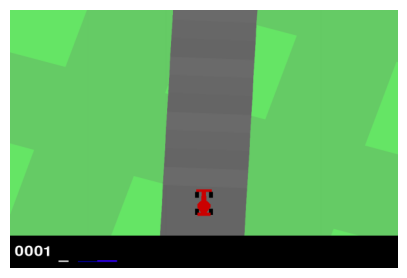

In [39]:
total_rewards, frames = traineSoftUpdateDQN_exp2.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

In [40]:
print(f"Total reward for Soft Update Double DQN (tau = 0.005): {total_rewards}")

Total reward for Soft Update Double DQN (tau = 0.005): 629.4816254416863


Your answer: